This is the Jupyter notebook containing most of the code for the projects. There is a lot happening so I will try to explain what's going on . The amount of variables and datasets used can be a bit daunting as well. I tried to limit those by using functions for a while but didn't get to do that for now. Hopeffuly I get to explain the functions as well. Those can be found in the "utils.py" file. You need it to run the notebook.

If you want to adapt this code to fit yours you will most certainly have to change the variables' names. I will try to make that as easy as possible. Information about the code will be commented out within the python cells. 

In [1]:
import pandas as pd 
import numpy as np
import os
import random
import glob
import re
import pickle


from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, AdaBoostClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder, QuantileTransformer
from sklearn.compose import ColumnTransformer, TransformedTargetRegressor,make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate,GridSearchCV
from sklearn.metrics import mean_squared_error, explained_variance_score, r2_score, recall_score,precision_recall_fscore_support, confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPRegressor, MLPClassifier


import tensorflow as tf
from tensorflow import keras 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.losses import MeanSquaredError, MeanSquaredLogarithmicError
from tensorflow.keras.optimizers import Adam

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import geopandas as gpd
from shapely.geometry import Point, Polygon
import calplot 
import folium
import streamlit as st

import plotly.express as px 
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from dash import Dash, dcc, html, Input, Output


from time import time 

import datetime


from streamlit_folium import st_folium
from  utils import (noiseprocessing, groupdata, meteoprocessing, groupmeteo, double_lineplot, mapoutliers,longitude,latitude,
                    weather_sound_map, read_data, noisecat, school_calendar, time_of_day,min00,event_type_freq,get_coord,inbound,
                    residuals_by,plot_predictions,Preprocess_to_sequence,Validation_Loss_Accuracy, plot_class_proba, True_False_positive,
                    residuals_by,plot_predictions,Validation_Loss_Accuracy,plot_class_proba,True_False_positive)


import warnings
# warnings.filterwarnings("ignore", category=FutureWarning, module="pandas")
# warnings.filterwarnings("ignore", category=FutureWarning, module="Matplotlib")
# warnings.filterwarnings("ignore", category=UserWarning, module="Matplotlib")
warnings.filterwarnings('ignore')
random.seed(36)




In [2]:
#########################################
#       User input below on row 59      #
#########################################


# On the row below this set of code, between the brackets you have to set the path to the folder called 'Data'
# This folder can be found in the following path of the downloaded folder called App: App/Data 
# An example is: dir_data_folder="/Users/jonas/Documents/KU Leuven/Year 4/Semester 2/Modern Data Analytics/Assignment/App/Data/"
#Insert the folder where your data is and where the saved models are 

dir_data_folder="C:/Users/terli/Programs/Python/Projects/Latvia_Noise_in_leuven/Data/"


#########################################
#       User input above on row 59      #
#########################################
dirmeteo=os.path.join(dir_data_folder, "Meteo/*.csv")
dirclass=os.path.join(dir_data_folder, "Classified_events/*.csv")
dirpercent=os.path.join(dir_data_folder, "Percentiled_data/*.csv")
direvent=os.path.join(dir_data_folder, "Events/*.csv")


LSTM_checkpoint=os.path.join(dir_data_folder, "Models/LSTM_checkpoint.ckpt")
History_LSTM_file=os.path.join(dir_data_folder, "Models/History_LSTM.pkl")

MLP_file_sav=os.path.join(dir_data_folder, "Models/MLP_regr_model.sav")
MLP_classifier_file=os.path.join(dir_data_folder, "Models/MLP_class_model.sav")

Weather_Metadata=os.path.join(dir_data_folder, "01_Metadata_v2.csv")
Sound_weather_file=os.path.join(dir_data_folder, "Sound_weather.csv")

In [3]:
# dirmeteo=r"D:\MDA\Data\Meteo\*.csv"
# dirsound=r"D:\MDA\Data\Sound\*.csv"
# dirclass=r"D:\MDA\Data\Classified_events\*.csv"
# dirpercent= r'D:\MDA\Data\Percentiled_data\*.csv'
# eventdir=r"D:\MDA\Data\Events\*csv"




# Weather_Metadata=r"C:\Users\terli\Programs\Python\Projects\MDA\Datasets\01_Metadata_v2.csv"

There are four different Datasets serving as input for our models. Two of them contain information about noise, one being percentiled recorded noise per hour over the year 2022 and the other one containing the predictions about the source those noise snippets. 
Another one contains the weather records of the year 2022, while the last one contains data about events and construction projects in Leuven. 

Percentiled Data: 

The Noise Data is recorded by hour in Decibels. And percentiled by hour. Meaning, the k-th percentile represent amount of decibels below which the percentage k of the hour falls. For example, if the 25th percentile of a given hour is 75 dB, that implies that the noise reached 75dB or more for 25% of the hour, ie 15 minutes. 

We start processing the Sound dataset. First, read through the files with the different locations and merge them, then, clan the whole dataset. Details of the process is described on the utils file. This is our main dataset, we will comeback to it later. 


In [4]:
Sound= noiseprocessing(read_data(dirpercent,';'))
print('This is the lenght: ' + str(len(Sound)) + ' and width ' + str(len(Sound.columns))+ ' of our dataset, all the folowing ones\' lengths must be the same' )

This is the lenght: 50320 and width 19 of our dataset, all the folowing ones' lengths must be the same


Weather Data: 
 
The weather data was collected by more than a hundred weather stations around Leuven. Each weather station collects information of the data every 10 minutes. Such information include the rain, wind direction, sind strength, corrected temperature or even radiations. The values will be averaged across all weather stations and hour. We will end up with a 8760 long dataframe.  
This is where the weather stations and the microphones were set up in Leuven:

In [5]:

Micro_loc=pd.DataFrame(data=zip(Sound['Location'].unique(),latitude,longitude),columns=['Loc','LAT','LON'])

map=weather_sound_map(Micro_loc,pd.read_csv(Weather_Metadata),width=1600,height=900)

display(map)

We will also group the data set by day to make some visualisations. 

In [6]:
hourly_sound=groupdata(Sound,'Hour')
daily_sound=groupdata(Sound,'Date')

The Meteo dataset has records coming from a hundred of different weather stations spread accross Leuven. We will average the records across the different stations to obtain the weather per hour in Leuven. There are records of weather every 10 minute. The hourly weather will be obtained by averaging the measures over a given hour. 

In [7]:
##Another kind of preprocessing is applied to this dataset. 
Base_Meteo=meteoprocessing(read_data(dirmeteo,','))
#The meteo grouped and average across all weather stations and hours, and to allow some visualisation with the noise dataset, by day. 
Meteo=groupmeteo(Base_Meteo,'Hour')
daily_weather=groupmeteo(Base_Meteo,'Date')

We are eager to see if there is somesort of correlation between the temperature and the level of noise in Naamsestraat. 

In [8]:
#Merging the two datasets 
Sound_Weather_day= pd.merge(daily_weather,daily_sound,on='Date',how='outer')

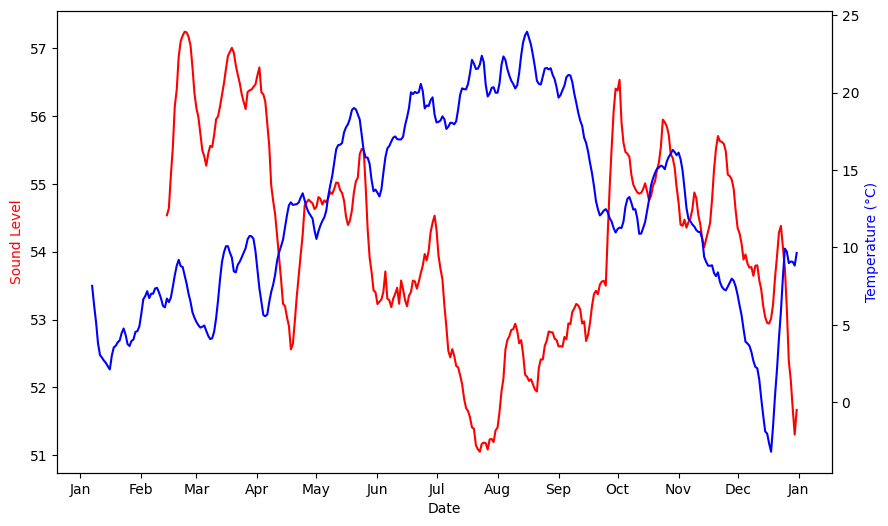

In [9]:
double_lineplot(Sound_Weather_day,'avg_laf25_per_hour','avg_LC_TEMP_QCL3','Date','Date','Sound Level','Temperature (°C)')

Which doesn't seem to be the case, actually, the trend of the noise seems to follow the university's calendar. 
Looking at the calendar heatmap below it appears even more clearly. 

findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.
findfont: Font family 'Helvetica' not found.


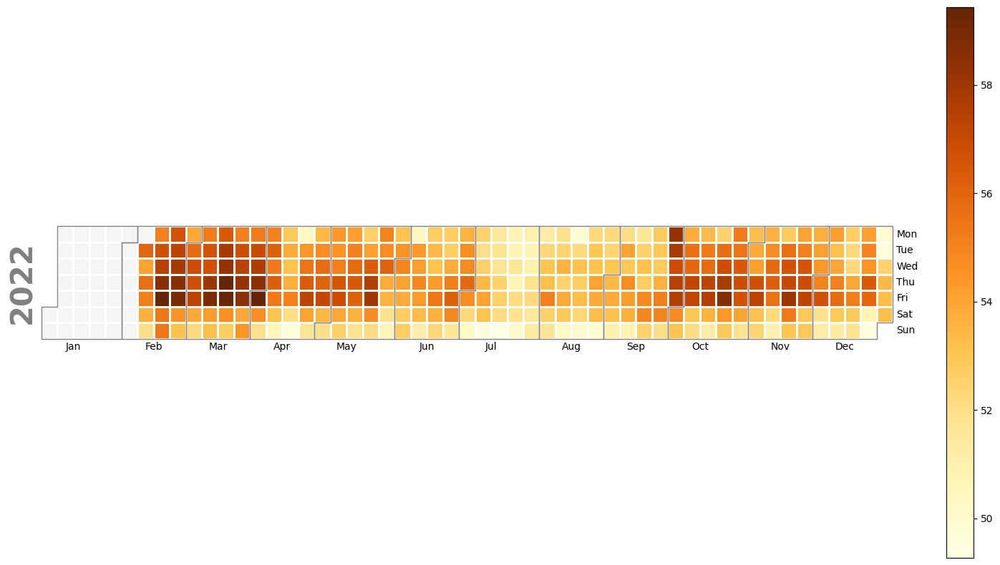

In [10]:
fig_df=pd.concat([(pd.DataFrame(index=range(38),columns=daily_sound.columns)),daily_sound],ignore_index=True)

missing_day=pd.DataFrame({'Date':pd.date_range(start='2022-01-01',end='2022-02-07')})
fig_df['Date']=fig_df['Date'].fillna(missing_day['Date'])
fig_df['Date']=pd.to_datetime(fig_df['Date'],format='%Y-%m-%d %H:%M:%S')
Sound_calendar=pd.Series(fig_df.set_index('Date')['avg_laf25_per_hour'])
Calendarmap=calplot.calplot(Sound_calendar,dropzero='True',cmap='YlOrBr',figsize=(16,8))
Calendarmap[0].show()

Now, back to the main dataset, we are given different percentile of Noise. Let's see how those behave. 

In [11]:
# Noise=(Sound.filter(regex='laf').columns)
plots=(Sound.drop(Sound.filter(regex='unit').columns,axis=1).drop(['id','Vacation','Time_of_Day'],axis=1)).melt(id_vars=['Date_time','Date', 'Time','Location'])
boxfig=px.box(plots,x='variable',y='value',color='variable',color_discrete_sequence=px.colors.qualitative.T10)
boxfig.show()

It does seem like there are many outliers in the dataset, this might be caused by some timerelated trend. Once again, roughly following the school calendar. 

In [12]:
mapoutliers(Sound,'laf005_per_hour')

1038


Classified noise Sequences: 
Some detected noise sequences were classified by some algorithm. We will use those to give us an indication of traffic (as cars sometimes get detected) but also how many potentially disturbing noise sources occur during a given hour. 

For that dataset to be merged with the one above, two things need to occur. We first change all the times of the events into round hours and then compute the frequence of each event occuring in an hour. We will also only keep the events that were classified with more than 50% certainty. 

In [13]:
##We import the Dataset 
Noise_class_perhour=noiseprocessing(read_data(dirclass,';'))

##All the hours are changed into round hours
Noise_class_perhour['Date_time']= noiseprocessing(read_data(dirclass,';'))['Date_time'].apply(lambda a: min00(a))
#Classifications with less than 50% certainty are being discarded
Noise_class_perhour=Noise_class_perhour.loc[(Noise_class_perhour['Certainty']>=50)]
#We create a column 'Count', equal to one. This will make the computation of our event classifications easier. 
Noise_class_perhour.loc[:,'count']=1

We proceed to compute the frequence of each event.

In [14]:
#We pivot the table based on the Date and time and Location for the  Class column and aggregate the corresponding values of the previously created "Count" column. 
#This creates a column for eaach category of the Class column indexed on time and Location, meaning we are kept with the count of each event by hour and location (matching our initial dataset size)
pivot=pd.pivot_table(Noise_class_perhour,values='count', index=['Date_time','Location'],columns='Class',aggfunc='count')
#The dataset is filled with missing values for the hours in which no events were detected, we want those to be equal to 0 instead and get rid of the double index set above. 
pivot=pivot.fillna(0).reset_index(level=['Date_time','Location'])
pivot.describe()

#For the sake of readability and use we rename the columns
pivot.rename(columns={'Human voice - Shouting':'Shouting','Human voice - Singing':'Singing','Music non-amplified':'Music','Nature elements - Wind':'Wind','Transport road - Passenger car':'Car','Transport road - Siren':'Siren'},inplace=True)
#Create a list of the detected noise, just in case. 
detected_noise=['Shouting', 'Singing', 'Music', 'Wind', 'Car','Siren']

This Plotly dash plot display the count of detected events throughout the year. 

In [15]:
app= Dash(__name__)
app.layout=html.Div([
    html.H4('Source Noise frequence'),
    dcc.Graph(id='Source_chart'),
    html.P('Select Source'),
    dcc.Dropdown(
        id="ticker",
        options=['Shouting', 'Singing', 'Music', 'Wind', 'Car',
       'Siren'],
       value="Shouting",
       clearable=False,
    )
])
@app.callback(
    Output("Source_chart","figure"),
    Input("ticker","value"))
def display_fig(ticker):
    df=pivot
    fig=px.histogram(df,x=df['Date_time'].dt.date,y=ticker,color=ticker)
    fig.update_traces(marker=dict(color='#32a846'))
    return fig
    # app.run_server(debug=True,use_reloader=False)

We then proceed to import the Data about potential disturbing events or Construction Sites. The data collected was done so by the city of leuven it registered every single potentially disruptive event happening in the city, from construction projects, to containers laying on the streets, scaffholdings or otheer events.


In [16]:
#One again we read the data 
Events=read_data(direvent,',')

#Rename several columns
Events.rename(columns={'Einde':'End','Soort':'Sort','Categorie':'Category','Locatie':'Location','Id':'id'},inplace=True)

#We remove those evetns who start on different periods. And we  convert the start and end date columns into pandas datetime foramt 
Events=Events[Events['Start']!='meerdere periodes']
for i in ['Start','End']:
    Events[str(i)]=pd.to_datetime(Events[str(i)],format='%d-%m-%Y %H:%M')

#We drop duplicate events
Events=Events.sort_values('End',ascending=True).drop_duplicates(subset='id',keep='last')

This Data Set contains a lot of different work projects and event. Therefore we will only keep those that occur strictly around Naamsestraat. For every event the corresponding coordinates (Lambert 72, Belgian system) are provided. 

In [17]:
#We will keep the events that solely happen in Naamsestraat
#Strictly Naamsestraat
Top_left=[173230.000000,174395.00000]
Bottom_left=[173230.000000,173230.0000]
Top_right=[173500.00000,174395.00000]
Bottom_right=[173500.000000,173230.0000]


#Broad Naamsestraat
# Top_left=[17300.0000,174760.0000] 
# Bottom_left=[17300.0000,173345.0000] 
# Top_right=[174375.0000,174760.0000] 
# Bottom_right=[174375.0000,173345.0000] 


#Roughly Leuven's coordinate
# Top_left=[171933.0000,175720.0000] 
# Bottom_left=[171933.0000,171765.0000] 
# Top_right=[175325.0000,175720.0000] 
# Bottom_right=[175325.0000,171765.0000] 

R_limit=Bottom_right[0]
Down_limit=Bottom_right[1]
L_limit=Top_left[0]
Up_limit=Top_left[1]


We extract the coordinates from the dataset and determine if they happen to be in the close vicinity of Naamsestraat. 

In [18]:
#if the coordonates happen to be in the rectangle specified above we keep the event. Since the coordinate column contains strings this need some manipulation. 
Events['Coordinates']=Events['Location'].apply(lambda x: get_coord(x))

#We create a dummy varaible, equal to one if the veent is within the area around naamsestraat
Events['In_limit']=Events['Coordinates'].apply(lambda x: inbound(R_limit,Down_limit,L_limit,Up_limit,x))

Events=Events[Events['In_limit']==1].drop(['Location','In_limit','Category'],axis=1)

In this dataset, we are given a start and a end time. We therefore want to count  how many events are ongoing on which hour. We are given three categories: Event, work and groundwork 

In [19]:
#We create a dataset with hours throughout the year 2022.
start_date = datetime.datetime(2022, 1, 1)
end_date = datetime.datetime(2022, 12, 31, 23, 59)
date_range = pd.date_range(start=start_date, end=end_date, freq='H')
Year_events=pd.DataFrame()
Year_events['Date_time']=date_range

# Year_events['Events_info']= ''
Year_events['Event_type']=''
print('The dataset Year_events' + ' has a column ' + str(Year_events.columns[0])+ ' and empty column ' + str(Year_events.columns[1])+ ', for now.')

The dataset Year_events has a column Date_time and empty column Event_type, for now.


In [20]:

#If a given hour lays between the start and end date of an event, such event will be added in a list which will fill the empty value of the Year_events Dataframe. 
for index, row in Year_events.iterrows(): 
    current_hour=row['Date_time']
    matching_events= Events[(current_hour>=(Events['Start'])) & (current_hour <= (Events['End']))]
  
    event_type_list=matching_events['Sort'].tolist()
    
    Year_events.at[index, 'Event_type'] = event_type_list

print('For the time being that is what the dataframe where we store the events going on for every hour looks like:')
print(Year_events.head())


For the time being that is what the dataframe where we store the events going on for every hour looks like:
            Date_time                                         Event_type
0 2022-01-01 00:00:00  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
1 2022-01-01 01:00:00  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
2 2022-01-01 02:00:00  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
3 2022-01-01 03:00:00  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
4 2022-01-01 04:00:00  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...


In [21]:

#We create a new column for each type of events. The value in that column is the amount of time that event appears in the list. 
#Hence, the amount of that type of event happening around Naamsestraat At that given hour. 
for sort in event_type_list:
    Year_events[f'{sort}']=Year_events['Event_type'].apply(lambda x: event_type_freq(f'{sort}',x))

print(Year_events[['Evenement','Event_type']].head(5))

   Evenement                                         Event_type
0          7  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
1          7  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
2          7  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
3          7  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...
4          7  [Evenement, Werk, Werk, Werk, Werk, Grondwerk,...


We then proceed to merge all four Datasets. First the two noise ones on Time and Location and then the Weather and event dataset on time. 

In [22]:
# The Dataset we merge all the others on is the percentiled noise one, every merge is based on the hour, 'Date_time' except from the first one where we want to keep the locations specific.
# We then merge the dataset containing the classifications, not all the date appears so we will fill the missing values with 0. 
# Because we assume no cars, shouting or singing were detected. Next we mearge the dataset with the events, droping the variable with the list of events.
# And, only keeping the columns with the counts of those events. Lastly we add our weather dataset. 

Sound_weather= pd.merge(Sound,pivot,on=['Date_time','Location'],how='left').fillna(0).merge((Year_events.drop('Event_type',axis=1)),on=['Date_time'],how='left').merge(Meteo,on=['Date_time'],how='left')

print('Initially our dataset had the following shape' 
      + str(Sound.shape) + ' so we expect this one to have the same length, that being: ' + str(len(Sound_weather)) + ' and much more columns of course, here: '
+ str(len(Sound_weather.columns))) 


Initially our dataset had the following shape(50320, 20) so we expect this one to have the same length, that being: 50320 and much more columns of course, here: 36


To that we make some adjustements, essentially minor feature engeneering such as:extracting the month, the day of the week and the hour of the day from the Date_time column. We want to keep those variables as strings because float or integers will be standardised down the line. In such case our models wouldn't be able to extract any valuable information. 


In [23]:
#To that we make some adjustements, essentially minor feature engeneering such as:

#Extracting the month of the year
Sound_weather['Month'] = Sound_weather['Date_time'].apply(lambda w: w.strftime('%B'))

#The day of the week
Sound_weather['Day_of_week'] = Sound_weather['Date_time'].apply(lambda w: w.strftime('%A'))

#And the hour of the day 
Sound_weather['Hour']=Sound_weather['Date_time'].dt.hour.astype(str)


#One specific date and time appears twice, we therefore delete the duplicates 
Sound_weather=Sound_weather.drop_duplicates(['Date_time','Location'],keep='last')

#Sort the dataframe for upcoming manipulations
Sound_weather=Sound_weather.sort_values(['Location','Date_time'])

#And create an index from one to 50320, sorted by Location and Date_time
Sound_weather.reset_index(drop=True, inplace=True)


Sound weather is our dataset containing all the information we have gathered. It contains 50320 rows and 38 columns

In practice, anyone predicting the level of noise at a given hour wouldn't have the amount of cars detected for that hour. We need to tweak the data a bit to ensure our model is usable in real-time. Therefore, for a given hour, we will use the cummulative sum of noise sources up until that hour. The cummulative sum resets for every 12:00 and is specific for every single location. The assumption is that we the sum of noise up until the 22:00 of the 31st of december doesn't provide much information about the amount of noise for the next hour. 
Therefore, the sum of noise will be per day. However, we are mainly interested in the noise level at night and doing it per day would mean loosing all the potentially predictive cummulative sum of noise at midnight. 
Hence, the count will be reset at 12:00 everyday. 

In [24]:

#The approach we are taking to do so is creating a column upon which we will index our cummulative sum. 
#Therefore, for every location, every sequence of 12:00 get assigned a index. 
Sound_weather['ind']=''

#In the loop below, n is the index. n is 0, until either one of those two conditions are met: 
#Either, it is 12:00 or if the Location in a row is different than the previous one. 

# (Remember, we sorted the dataset by Location, and Time. Meaning if we itterate through the rows, Location will change. 
# If the  sum was to go on, one location's detected sources of noise on Naamsestraat would carry on being summed on another on the count of another one. Which, we want to avoid)
n=0
for index, i in Sound_weather.iterrows():
    if index==0: 
        Sound_weather.loc[index, "ind"]=n
    else :
        if str(i['Time'])=='12:00:00' or i['Location']!= Sound_weather.loc[(index-1),'Location']:
            n+=1
            Sound_weather.loc[index, "ind"] = n
        else:
            Sound_weather.loc[index, "ind"]=n


In [25]:
#First we need to shift all our counts of noise by one row down, (for the reason explained above). 
#We then apply the cummulative sum of the shifted count of noise source on our index above. 
for source in detected_noise: 
    Sound_weather[f'shifted_{source}']=Sound_weather.sort_values(['ind','Date_time'])[[f'{source}']].shift(periods=1)
    Sound_weather.loc[0,f'shifted_{source}']=0 #---> Since we shift our column, the first instance is 0, and we loose the last one. 
    Sound_weather[f'cum_{source}']=Sound_weather.sort_values(['ind','Date_time']).groupby(['ind'])[f'shifted_{source}'].cumsum()
 



Managing the amount of noise in Naamsestraat would be far more trivial if one could predict, for any time and location, what the noise level would be for a given duration. In other words we want to predict for every our what the we can expect the noise to be for a give time duration. 
Essentially, what we are aiming at is predicting what the different percentiles of noise will be for each hour. Meaning, we are treating every single percentile as a single instance. 

In [26]:
#We transform the dataset to have our percentile variables as single instances, we transform columns into rows essentially. 
Individual_Record=Sound_weather.melt(id_vars=(Sound_weather.filter(regex=r'^(?!laf)').columns)).drop(
             ['Date_time','Date','Time','id','shifted_Siren', 'shifted_Car','shifted_Singing','ind','Shouting', 'Singing', 'Music',
            'Wind', 'Car', 'Siren','shifted_Shouting','shifted_Wind','shifted_Music'],axis=1)

In [27]:
#We compute the variable, 'Sound duration' which essentially the amount of time a percentile would correspond to in minutes. The 25th percentile corresponding to 15 minutes. 
Individual_Record['Sound_duration']=(Individual_Record['variable'].apply(lambda a: (
    float(re.findall('\d+',a)[0])/1000) if a in ['laf005_per_hour','laf995_per_hour'] else (float(re.findall('\d+',a)[0])/100)))*60

#This is WHO's recomendation for maximal time of exposure for a given sound level. unfortunately, given the nature of the data, vey little amount of observations fit that category. 
#Source: https://www.engineeringtoolbox.com/noise-exposure-level-duration-d_717.html
Individual_Record['max_time_of_exposure']=(480/(2**((Individual_Record['value']-85)/3)))

#Here we drop the final variables we won't need
training_set=(Individual_Record[Individual_Record.filter(regex=r'^(?!value)').columns]).drop(['variable','max_time_of_exposure'],axis=1)

In [28]:
#We define our numerical columns and categoricals ones for later on in our model. 
numeric_cols=training_set[training_set.filter(regex=r'^(?!value)').columns].select_dtypes(include=['float','int']).columns
categorical_cols=training_set[training_set.filter(regex=r'^(?!value)').columns].select_dtypes(include=['object']).columns

print(' Our model will have the following numerical input variables :' )
print(*numeric_cols)
print('')
print('And categorical variables: ' )
print(*categorical_cols)

 Our model will have the following numerical input variables :
Werk Grondwerk Evenement avg_LC_HUMIDITY avg_LC_RAD avg_LC_RAININ avg_LC_DAILYRAIN avg_LC_WINDDIR avg_LC_WINDSPEED avg_LC_TEMP_QCL3 cum_Shouting cum_Singing cum_Music cum_Wind cum_Car cum_Siren Sound_duration

And categorical variables: 
Location Vacation Time_of_Day Month Day_of_week Hour


The dependent variable is the percentiled noise level per hour. 

In [29]:
y=pd.DataFrame(Individual_Record['value'])

To perform such predictive model we will employ sklearn regression multi-layer perceptron. We will split our data into a training data set made of 85% of the intitial dataset, the rest being used to test our model. Numerical variables will be standardised while our categorical input variables will be dummified. The distribution of the noise being highly skewed towards the high values, a logarithmic transformation will also be applied to our dependent variable. 

In [30]:
#Train and test split
X_train,X_test,y_train,y_test= train_test_split(training_set,y,test_size=0.15,shuffle=True)

In [31]:
#Sklearn MLP_predictor

numeric_transformer=Pipeline([("scaler",StandardScaler())])
Categorical_transformer=Pipeline([("Dummy_encoder",OneHotEncoder())])
preprocessor= ColumnTransformer([('numeric_preprocessing',numeric_transformer,numeric_cols),
                                    ('categorical_preprocessing',Categorical_transformer,categorical_cols)])
MLP_predictor= MLPRegressor( 
    activation='relu',
    random_state=36,
    hidden_layer_sizes=(80,30,10),
    learning_rate='invscaling',
    learning_rate_init=0.01,
    max_iter=100,
    early_stopping=True) 


In [32]:
''' These lines run the model and train it. You can also load the weights directly'''

# MLP_pipeline=TransformedTargetRegressor(regressor=(Pipeline([('all_column_preprocessing',preprocessor),('MLP_predictor',MLP_predictor)])),func=np.log,inverse_func=np.exp)
# MLP_pipeline.fit(X_train,y_train)
# pickle.dump(MLP_pipeline,open(MLP_file_sav, 'wb'))

' These lines run the model and train it. You can also load the weights directly'

In [33]:

MLP_pipeline=pickle.load(open(MLP_file_sav, 'rb'))

predictions=MLP_pipeline.predict(X_test)

The plot below shows the residual against the true values of y. As on can easily notice, the model isn't very accurate in general and seems to predict high noise values very poorly. 
The Second plot shows the predictions plotted against the true_values, ideally one would hope those to be on a straight line. Which isn't the case here, especially as the true_values increase. 

In [34]:
Regr_result=X_test
Regr_result['Predictions']=predictions
Regr_result['True_values']=y_test['value']
Regr_result['Residuals']=Regr_result['True_values']-Regr_result['Predictions']

Resi_plot= px.scatter(Regr_result,x='True_values',y='Residuals',labels={'x':'True_values','y':'Residuals'},color='Residuals', color_continuous_scale=px.colors.cyclical.Edge)
Resi_plot.show()

In [35]:
predi_plot= px.scatter(Regr_result,x='True_values',y='Predictions',labels={'x':'True_values','y':'Predictions'},color='True_values', color_continuous_scale=px.colors.cyclical.Edge)

predi_plot.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y.min(), y0=y.min(),
    x1=y.max(), y1=y.max()
)
predi_plot.show()

In [36]:
Sound_weather=pd.read_csv(Sound_weather_file,index_col=0)

Clearly the model doesn't perform well. It could be that the model is at fault here but it is more reasonable to assume that the approach is wrong. Predicting the level of noise given the percentile, or duration of it, is very optimistic. It is unlikely that a static regression model will be able to pick up the necessary information to predict the noise level, especially by percentile, or duration for that matter. 

Instead, we could have a more hands on perspective on the problem. We want to be able to predict when some police intervention, or any other preventive action is required, and more specifically at night. 
Therefore, we turn our static regression problem into a classification one. 
Our first step will be to create a class, in other words, determine what could be a nuisance? 

We want to ensure the people living in the neighbourhood get quality and uninterupted nights of sleep. Therefore we will focus on the nocturnal noise. 
Regions usually divide the day in different time periods were different noise legislations apply. For Brussels they go as follows: 
From 07:00 to 19:00, 19:00 to 22:00 and 22:00 to 07:00. (Different in the weekend but we will ignore that). Those will be labled as Day, Evening and Night. We will consider that disturbing level of noises will only occur at night. 

The noise treshold is set at 65dB outside, for more than 3 minutes. Meaning the level of noise exceeded 65dB for more than 3 minutes during that hour.
If the microphones detected more than 65 dB for a fiven hour at night, the instance will be classified as a 'Nuisance'. 
The WHO recommends outside areas to not exceed 70dB outside and 55dB outside and at night to avoid negative health effects. Thus, one could even say that such a treshold is conservative. 

In [37]:
#We create a new dataframe without the lowest percentiles
Class_nuisance=Sound_weather.drop(['laf005_per_hour','laf01_per_hour'],axis=1)


'''Feel free to play around with the noise treshold, the value inside the gt() function, it does change the class repartition which affect the model quite a bit'''
#We initialise our class, equal to one when both conditions mentioned above are 
Class_nuisance['Nuisance'] = (Class_nuisance[Class_nuisance.filter(regex='laf').columns].gt(65).any(axis=1)) & (Class_nuisance['Time_of_Day'] == 'Night').astype(int)
Class_nuisance['Hour'] = Class_nuisance['Hour'].astype(str)

Class_nuisance=Class_nuisance.loc[Class_nuisance['Time_of_Day']=='Night']

Class_trainingset=Class_nuisance.drop(Class_nuisance.filter(regex='laf').columns,axis=1).drop(
    #We drop the variable than are either not relevant, that would result in too many dummy variables when one hot encoded or  that one would realistically not have access toat prediction time
    ['Date_time','Date','id','Time','id','ind','Shouting', 'Singing', 'Music','Wind', 'Car', 'Siren'],axis=1)

print('Only keeping the observations at night leaves us with a total of ' + str(len(Class_trainingset)) + ' among which ' + str(Class_nuisance.Nuisance.sum()) + ' are potentially disturbing.')

Only keeping the observations at night leaves us with a total of 18882 among which 2017 are potentially disturbing.


In [38]:
#Once again we define our numerical and categorical
numeric_cols=Class_trainingset[Class_trainingset.filter(regex=r'^(?!value)').columns].select_dtypes(include=['float','int']).columns
categorical_cols=Class_trainingset[Class_trainingset.filter(regex=r'^(?!value)').columns].select_dtypes(include=['object']).columns

#Create our training and test set 
X_class=Class_trainingset.drop('Nuisance',axis=1)
y_class=Class_trainingset['Nuisance']
ClassX_train, ClassX_test, Classy_train, Classy_test= train_test_split(X_class,y_class,test_size=0.2,shuffle=True)

#A small fraction of the dataset will be set aside to validate our model
ClassX_test, ClassX_val, Classy_test, Classy_val= train_test_split(ClassX_test,Classy_test,test_size=0.05,shuffle=True)


print(' Our model will have the following numerical input variables:' )
print(*numeric_cols)
print('')
print('And categorical variables: ' )
print(*categorical_cols)

 Our model will have the following numerical input variables:
Evenement Werk Grondwerk avg_LC_HUMIDITY avg_LC_RAD avg_LC_RAININ avg_LC_DAILYRAIN avg_LC_WINDDIR avg_LC_WINDSPEED avg_LC_TEMP_QCL3 shifted_Shouting cum_Shouting shifted_Singing cum_Singing shifted_Music cum_Music shifted_Wind cum_Wind shifted_Car cum_Car shifted_Siren cum_Siren

And categorical variables: 
Location Vacation Time_of_Day Month Day_of_week Hour


In [39]:
#Classifier:

numeric_transformer=Pipeline([("scaler",StandardScaler())])
Categorical_transformer=Pipeline([("Dummy_encoder",OneHotEncoder(handle_unknown='ignore'))])
preprocessor= ColumnTransformer([('numeric_preprocessing',numeric_transformer,numeric_cols),
                                 ('categorical_preprocessing',Categorical_transformer,categorical_cols)])
MLP_classifier= MLPClassifier( 
    activation='tanh',
    hidden_layer_sizes=(100,80,30,20),
    learning_rate='invscaling',
    learning_rate_init=0.001,
    max_iter=1000

)


Down below is our model's pipeline. 

In [40]:
MLP_Class_pipeline=Pipeline([('all_column_preprocessing',preprocessor),('MLP_predictor',MLP_classifier)])

In [41]:
# MLP_Class_pipeline.fit(X_class,y_class)
# pickle.dump(MLP_Class_pipeline, open(MLP_classifier_file,'wb'))

MLP_Class_pipeline=pickle.load(open(MLP_classifier_file,'rb'))

In [42]:
MLP_predicitons=MLP_Class_pipeline.predict(ClassX_test)
results=precision_recall_fscore_support(Classy_test,MLP_predicitons)


FP,FN,TP,TN=True_False_positive(Classy_test,MLP_predicitons)

print('The model was tested on a dataset containing ' + str(results[3][1]) + ' classified as Nuisances on a total of ' + str(results[3][0]) + ' observations')
print('The precision of our model is the following for our class of interest: ' + str(results[0][1]) +'. The precision is intuitively the ability of the classifier not to label a negative sample as positive.')
print('The recall of our model is the following for our class of interest: '+ str(results[1][1])+ '. The recall is intuitively the ability of the classifier to find all the positive samples.')

print('We get '+ str(FP[1]) + ' False positives, ' + str(FN[1]) + ' False negatives, '+ str(TP[1]) + ' True positives, '+ str(TN[1]) + ' True negatives.' )
print('In total, our model predicted ' + str(FP[1] + FN[1]) +' outcomes wrong')


The model was tested on a dataset containing 410 classified as Nuisances on a total of 3178 observations
The precision of our model is the following for our class of interest: 0.9975609756097561. The precision is intuitively the ability of the classifier not to label a negative sample as positive.
The recall of our model is the following for our class of interest: 0.9975609756097561. The recall is intuitively the ability of the classifier to find all the positive samples.
We get 1 False positives, 1 False negatives, 409 True positives, 3177 True negatives.
In total, our model predicted 2 outcomes wrong


The model is fairly accurate, we want to avoid false positive since that would imply, in case it that would be the response to our model's prediction, a pointless police intervention. Or, a false negative because that would imply that neighbours' quality of sleep would have been impacted, which we would like to avoid too. 



In [43]:


MLP_proba=MLP_Class_pipeline.predict_proba(ClassX_test)

# def plot_class_proba(df:pd.DataFrame,target_list,prediction_list,probability_list):
#     class_df=pd.DataFrame()
#     class_df['True_class']=target_list
#     class_df['Predictions']=prediction_list
#     class_df['Proba']=probability_list[:,1]

#     mergeddf= class_df.merge(df, left_index=True, right_index=True,how='inner')

#     mergeddf['Outcome'] = np.where(mergeddf['True_class'] == mergeddf['Predictions'], 'Correct', 'Wrong')
#     Class_fig=px.scatter(mergeddf,x='laf10_per_hour',y='Proba',color='Outcome',color_discrete_sequence=px.colors.qualitative.T10,hover_data=['Nuisance','Location','Date_time'])
#     Class_fig.show()

plot_class_proba(Class_nuisance,Classy_test,MLP_predicitons,MLP_proba)

The plot shows the probability of our predictions against the value of the 25th percentile.

It is safe to say that, if our goal was to predict if a certain hour at night will exceed a given treshold the model above would perform rather well. However, keeping individual locations might cause some overfitting on our model. The microphones are set up very close to each other so it is likely taht the noise level is similar accross locations. Hence, the model might pick up a specific fate and hour to be loud because in the training set, another location with the timestamp was loud that night. Had we averaged noise accross locations, only a singletimestamp would have appeared in the  dataset. Such procedure would have highly reduced the size of our training set. Nevertheless, those are just assumptions, the model might be performing fine in real life scenarios. 

That being said, the model does show a couple of other drawbacks: 
- It only takes into acount Night noises, and only predicts those. It does not take into account any of the information we have during the day except from the cumulative count of classified events. 
- It is static, the model only takes into account the information available about the next hour at t_0 to predict the noise for the next hour. If used in real time, using the model would imply assuming the weather of the next hour, or any other information. The count of people singing or car noises detected has been adjusted in this model unlike the weather. That being said, It can be argued that the previous hour's weather or a forcast of thenext one would be sufficiently similar to enable an accurate prediction. Nonetheless, it is reasonable to assume that the recorded noise from the past influences the noise in the next hour, ideally we would keep all the information available. 
- Once deployed, the model's accuracy is hard to monitor. The model provides no information about the predicted level of noise, only the probability that an event fits the category 'Nuisance', which is the minority class. Therefore, if the model's predictions were to decay, it would take longer to realise, as only hours at nights could showcase that. 
- And last but not least, the quality of the model highly depends on the noise treshold considered, one could be interested in predicting the actual level of noise as was tried in the first MLP regression model. Such model would also enable noise to be predicted during the day. 


To make those adjustments, we will consider another type of neural network architecture, that will allow us to make use of all the information we need and predict the level of noise of an hour given a sequence of all the information in the previous hours. Such thing is possible using Long-Short-Term Memory neural networks. Unlike other architectures, shuch as the Multi-layer-perceptron above, which is a feedforward neural network, LSTM feedback  connections. Often used in speech or handwriting recognition , this architecture can process not only data points but entire sequences of data, which in the case of multi-varaible forcasting, can become a powerful asset.

The key to LSTM is that it uses different connections that assess events further back in the time sequence from those closer from the time of predictions, creating the so-called "memory". In broad terms, the architecture allow weights to be assigned based on how relevant a past instance is. 

In our model, we will use similar variables as the in the previous models and apply similar pre-processing methods. In the following model, one could have kept the actual noise value of an hour as an input variable for the next one. However, it is assumed that the microphones on Naamestraat won't stay there forever, and the goal of our model is to predict noise level without having the noise recorded. For the time being, the count of classified recorded events was kept in the model. 

The noise variable selected was the 25th percentile laf per hour. The amount of noise that was exceeded for 15 minutes in a given hour. 


In [44]:
warnings.filterwarnings("ignore", category=Warning, module="tensorflow")
Sound_weather=pd.read_csv(Sound_weather_file,index_col=0)

COLUMNS_TO_KEEP=['Date_time', 'Location', 'Vacation', 'Time_of_Day',
       'Shouting', 'Singing', 'Music', 'Wind', 'Car', 'Siren', 'Evenement',
       'Werk', 'Grondwerk', 'avg_LC_HUMIDITY', 'avg_LC_RAD', 'avg_LC_RAININ',
       'avg_LC_DAILYRAIN', 'avg_LC_WINDDIR', 'avg_LC_WINDSPEED',
       'avg_LC_TEMP_QCL3', 'Month', 'Day_of_week', 'Hour']
print(*COLUMNS_TO_KEEP)



Date_time Location Vacation Time_of_Day Shouting Singing Music Wind Car Siren Evenement Werk Grondwerk avg_LC_HUMIDITY avg_LC_RAD avg_LC_RAININ avg_LC_DAILYRAIN avg_LC_WINDDIR avg_LC_WINDSPEED avg_LC_TEMP_QCL3 Month Day_of_week Hour


Above, one can see the columns that we will keep, plus the predicted variable of course. Since we need to create a sequential dataframe, some reshaping and processing is necessary. 
First of all, we need to set our sequence window, which is the amount of hours we will feed to our model. If the window is set to 12 then each sequence will contain the data of the 12 previous ours. 
We will choose a window of 24 hours, arbitrarily, it might be that the window affects the predictions of the model. 
Every sequence of 24 hours, containing with the data shown above, will be used to predict the 25th one. 


In [45]:


X_seqtrain, X_seqtest, y_seqtrain, y_seqtest,X_seqval,y_seqval=Preprocess_to_sequence(Sound_weather,COLUMNS_TO_KEEP,'laf25_per_hour',window=24)

set_dict={}

list_ysets=[y_seqtrain,y_seqtest,y_seqval]
keys=['train','test','val']

for i, set_array in enumerate(list_ysets):
    key=keys[i]
    set_dict[key] = set_array[:,[0,1]]

y_seqtrain,y_seqtest,y_seqval=np.delete(y_seqtrain, [0,1], axis=1).astype('float32'),np.delete(y_seqtest, [0,1], axis=1).astype('float32'),np.delete(y_seqval, [0,1], axis=1).astype('float32')




With those columns as numeric variables
Shouting Singing Music Wind Car Siren Evenement Werk Grondwerk avg_LC_HUMIDITY avg_LC_RAD avg_LC_RAININ avg_LC_DAILYRAIN avg_LC_WINDDIR avg_LC_WINDSPEED avg_LC_TEMP_QCL3
With those columns as categorical variables
Location Vacation Time_of_Day Month Day_of_week Hour


Our preprocessing is done. We have created pairs of training, testing and validation sets with our input and output variables. Those respectively account for 65, 20 and 15 percent of the dataset.
It is important to keep in mind that because of the chosen window we lose 24 observations, indeed, since the model needs the previous hour, the first one to be predicted is the 25th. 

On top of that we have as a constraint that we want the prediction to be unique to their locations, we therefore leave the locations as an input variable. The reason is that if said experiment was to be deployed elsewhere in town, they might not be in such close proximity and locations may be even more relevant. We do not want the information of a location to be used to predict the noise from another one. 
For that reason, we do not only lose, 24 datapoints, but 24 datapoints times the amount of locations, so 192 data points in total. 

As a result of our processing we have also created a large number of new dimensions. Since all the categorical variables were dummy encoded, we now have 72 variables in total.

The final product of our reshaping is a training set with the following shape: 

In [46]:
print('Our training set has a the following shape', X_seqtrain.shape)

Our training set has a the following shape (32579, 24, 73)


In [47]:

History=pickle.load(open(History_LSTM_file, 'rb'))
LSTM_Model = tf.keras.models.load_model(LSTM_checkpoint)


Using tensorflow and the sequential model, we will use our training and test set to calibrate our model. We then build up a model with the following architecture: 

In [48]:
LSTM_Model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 60)                32160     
                                                                 
 dense_7 (Dense)             (None, 40)                2440      
                                                                 
 dense_8 (Dense)             (None, 16)                656       
                                                                 
 dense_9 (Dense)             (None, 1)                 17        
                                                                 
Total params: 35,273
Trainable params: 35,273
Non-trainable params: 0
_________________________________________________________________


We use the mean squared logarithmic error as a loss function to estimate our best model. Indeed, we are mainly interested in predicting the noise when it is disruptive, or higher. Therefore we do not want to punish large predictions or over-estimations error as much. 

In [49]:

# num_epochs=150

# LSTM_Model= Sequential()
# LSTM_Model.add(InputLayer((24,73)))
# LSTM_Model.add(LSTM(60))
# LSTM_Model.add(Dense(40,'relu'))
# LSTM_Model.add(Dense(16,'relu'))
# LSTM_Model.add(Dense(1,'linear'))

# LSTM_Model.summary()

# LSTM_check = ModelCheckpoint(LSTM_checkpoint,monitor='val_loss', save_best_only=True)
# LSTM_Model.compile(loss=MeanSquaredLogarithmicError(), optimizer=Adam(learning_rate=0.0001), metrics=['mse'])


# History=LSTM_Model.fit(X_seqtrain,y_seqtrain,validation_data=(X_seqtest,y_seqtest),epochs=num_epochs,callbacks=LSTM_check)


# pickle.dump(History, open(History_LSTM_file, 'wb'))

We now will assess our model performance by visualisation the residual in various context. It is important to note that the predicted and true values used for all the scores and plots will be done on the validation set to ensure that performance is based on unseen data (unless specified otherwise). Indeed, the best model is determined by the mean squared errors between from the trained model on the training set predicted values and  the test set true values. 


The final performance of our model is the following: 

In our preprocessing, we made sure to keep the locations and timestamps of every target values aside in order to compare how our model performs, in time, but also in space, at different locations. Below we construct a dataset containing, the true values, predictions, time-stamps and locations and residuals corresponding to our validation set. 



In [50]:

PREDICTIONS=(LSTM_Model.predict(X_seqval).flatten())
RESIDUALS=y_seqval.flatten()-PREDICTIONS
LOCATION_VAL=(set_dict['val'][:,0]).flatten()
DATE_TIME_VAL=pd.to_datetime(((set_dict['val'][:,1])).flatten())
LSTM_result=pd.DataFrame(data={'Predictions':PREDICTIONS,'True_values':(y_seqval.flatten()),'Location':LOCATION_VAL,'Date_time':DATE_TIME_VAL,'Residuals':RESIDUALS})
LSTM_result.head(n=5)

83/83 [==============================] - 1s 5ms/step


,Predictions,True_values,Location,Date_time,Residuals
0,46.481255,46.000000,Naamsestraat 62 Taste,2022-08-10 05:00:00,-0.481255
1,55.364750,55.900002,Naamsestraat 57 Xior,2022-07-25 16:00:00,0.535252
2,44.436863,43.900002,Naamsestraat 57 Xior,2022-11-29 05:00:00,-0.536861
3,64.004951,65.099998,Parkstraat 2 La Filosovia,2022-06-09 10:00:00,1.095047
4,53.909939,53.700001,Naamsestraat 81,2022-05-20 23:00:00,-0.209938


In [51]:
MSE=mean_squared_error(y_seqval.flatten(),PREDICTIONS)
print('Our model\'s mean squared error is equal to ' + str(mean_squared_error(y_seqval.flatten(),PREDICTIONS)) + ', while our test set\'s was of ' + str(np.min(History.history['val_mse'])))

Our model's mean squared error is equal to 3.0691953, while our test set's was of 4.00227165222168


The first plot shows the true values against the predictions. If the model performs well, the points should be along a 45° line, meaning the predictions are equal to the true values. 

In [52]:

fig2= px.scatter(LSTM_result,x='True_values',y='Predictions',labels={'x':'True_values','y':'Predictions'},color='Residuals', color_continuous_scale=px.colors.cyclical.Edge)
fig2.add_shape(
    type="line", line=dict(dash='dash'),
    x0=LSTM_result['Predictions'].min(), y0=LSTM_result['Predictions'].min(),
    x1=LSTM_result['Predictions'].max(), y1=LSTM_result['Predictions'].max(),
    layer='above'
)
fig2.show()

The second one is a ususal residual plot. Hopefully, our Residuals are around zero and constant along true values. 
Unfortunately, that doesn't seem to be the case, some high values of noise still seem to be underevaluated, those points might be outliers as the highest points in this plot are accurately predicted. 

In [53]:
fig3= px.scatter(LSTM_result,x='True_values',y='Residuals',labels={'x':'True values','y':'Residuals'},color=LSTM_result['Residuals'], color_continuous_scale=px.colors.cyclical.Edge)
fig3.show()

Now lets examine how our model performs over time: Predictions and True values are plotted next to each other, the further apart the points are the worse the prediction is of course. 

In [54]:
plot_predictions(LSTM_result,n_obs=300).show()

The predictions seems to be quite stable over time. Residuals don't seem to be correlated with time. We can further investigate such claim by plotting the residuals over time. 

In [55]:
residuals_by(LSTM_result,'Date').show()

The plot above shows the average residuals per day, accross location. It appears that the residuals fluctuates very little overall, but some points behave clearly outside of the trend. Especially around the end of exams or holidays. Both dates are on holidays, which might imply some festivities and hence some unforseen noise levels.  

In [56]:

residuals_by(LSTM_result,'Density_Day').show()


In [57]:
residuals_by(LSTM_result,'Density_Location').show()

As one can see, the average residual is very close to 0, once again, consistently under 0 which confirms that our model under-predicts. The model seems to be more consistent when it comes to predicting the the level of sound
Throughout the week than accross all locations. This might be due to the fact that every hour of the week appear the same amount of time while some locations have more observations than others. Since we kept all locations' sequences independent from one another, the model is more likely to train on the locations which appear the most in the overall dataset.

While not being perfect our LSTM based model offers very satisfactory results and valued properties. Our model makes use of all the information available and predicts not only the noise during the night but also during the day. Also, the model is dynamic and easy to maintain.
Deployment is also easily done as it only requires inforamtion available before the time of prediction. The metric chosen was the maximum noise level exceeded for 15 minutes, but setting up the model for any other metric would be simple, only the weights would have to be retrained. 
The model could also be refined. It could be beneficial to try out different time windows and add some features related to the precise days of exams and or holidays.
Training the model for individual locations could also be an alternative to get more accurate predictions.



The noise level of the previous hour is not an input variable in our model because we assumed it would be difficult to compute the percentiled noise of an hour while using it as an imput to predict the noise level o the next one.
Nothing stops us to add more laggs though, and predict the noise in two or more hours. An alternative would be to use the peak sound of the previous hour, which would, most likely be available by the time of prediction.

Last but not least, the model offers a lot of versatility as it could easily be converted in a classification problem if that would be desired, the pre-processing and model\'s architecture would vary slightly,the weights would have to be re-trained, but the framework would remain the same. If the model was to be used, we believe it would be a great tool to monitor and prevent disturbing level of noises in Naamsestraat before they occur'